<a href="https://colab.research.google.com/github/ViniciusCesarSena/Project_enem_23/blob/main/Project_Enem_23.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Projeto Enem 2023 Analysis

>Aqui estarão organizados os membros do grupo e os contribuidores do trabalho:

| Nome| RA|
|----------------|-------------------------------|
|Vinícius César Sena Torres|22409225|


In [ ]:
from google.colab import drive

drive.mount('/content/drive/', force_remount=True)
%cd '/content/drive/MyDrive'

Mounted at /content/drive/
/content/drive/MyDrive


In [ ]:
import pandas as pd
import matplotlib as mp
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import plotly.express as px
import seaborn as sns

##**Limpeza da base:**

In [ ]:
try:
  df = pd.read_csv('MICRODADOS_ENEM_2023.csv', encoding='latin-1', sep=';', low_memory=False)
  df_enem = df.copy()
except pd.errors.ParserError:
  print("Erro ao ler o arquivo CSV.Verificar formato do arquivo")

In [ ]:
print(f"A quantidade de linhas e colunas do dataframe original, respectivamente é: {df.shape}")

A quantidade de linhas e colunas do dataframe original, respectivamente é: (3933955, 76)


In [ ]:
df_enem.dropna(inplace=True)

In [ ]:
colunas_nao_utilizadas = [
    'NU_INSCRICAO', 'NU_ANO', 'TP_NACIONALIDADE', 'TP_PRESENCA_CN',
    'TP_PRESENCA_CH', 'TP_PRESENCA_LC', 'TP_PRESENCA_MT', 'CO_PROVA_CN',
    'CO_PROVA_CH', 'CO_PROVA_LC', 'CO_PROVA_MT', 'TP_STATUS_REDACAO',
    'NU_NOTA_COMP1', 'NU_NOTA_COMP2', 'NU_NOTA_COMP3', 'NU_NOTA_COMP4',
    'NU_NOTA_COMP5'
]

df_enem = df_enem.drop(colunas_nao_utilizadas, axis=1)

In [ ]:
print(f"A quantidade de linhas e colunas da tabela depois de excluir colunas não utilizadas e os valores nulos, respectivamente é: {df_enem.shape}")

A quantidade de linhas e colunas da tabela depois de excluir colunas não utilizadas e os valores nulos, respectivamente é: (708614, 59)


In [ ]:
colunas_selecionadas = [
'TP_FAIXA_ETARIA',
'TP_SEXO',
'TP_ESTADO_CIVIL',
'TP_COR_RACA',
'NU_NOTA_CN',
'NU_NOTA_CH',
'NU_NOTA_LC',
'NU_NOTA_MT'
]

df_analise = df_enem[colunas_selecionadas]

In [ ]:
df_analise.head(30)

,TP_FAIXA_ETARIA,TP_SEXO,TP_ESTADO_CIVIL,TP_COR_RACA,NU_NOTA_CN,NU_NOTA_CH,NU_NOTA_LC,NU_NOTA_MT
3,2,F,1,3,459.0,508.5,507.2,466.7
4,3,F,1,3,402.5,379.2,446.9,338.3
11,3,M,1,3,608.2,667.6,607.9,691.9
16,4,F,1,1,515.7,553.1,544.4,437.0
41,3,M,1,1,523.8,576.3,596.5,628.1
46,2,F,1,1,496.0,505.6,520.8,387.4
48,3,F,1,3,615.0,620.5,534.0,645.1
64,3,M,1,2,615.2,584.0,594.7,697.1
66,3,F,1,1,447.9,568.2,560.8,639.0
77,2,F,0,2,0.0,554.0,529.6,0.0


##**Análise Exploratória:**


# Análise de Correlação das Variáveis do ENEM

## Faixa Etária (Idade)
- **Correlação positiva fraca com as notas em Ciências da Natureza (0.12) e Ciências Humanas (0.13)**: Isso indica que um aumento na idade pode levar a um leve aumento nessas notas.
- **Correlação negativa fraca com Linguagens e Códigos (-0.16)**: Sugere que indivíduos mais velhos tendem a ter notas ligeiramente menores nessa área.
- **Correlação muito fraca positiva com a nota de Matemática (0.03)**: Indica uma relação quase nula entre idade e desempenho em Matemática.

## Estado Civil
- **Sem correlações significativas com as notas acadêmicas**: Todos os valores estão próximos de zero, indicando pouca ou nenhuma relação.

## Cor/Raça
- **Correlação negativa moderada com Ciências da Natureza (-0.26), Ciências Humanas (-0.22) e Linguagens e Códigos (-0.23)**: Sugere que certas cores/raças tendem a ter notas menores nessas disciplinas.
- **Correlação negativa mais fraca com a nota de Matemática (-0.10)**: Indica uma relação mais leve entre cor/raça e desempenho em Matemática.

## Nota em Ciências da Natureza
- **Correlação positiva forte com Ciências Humanas (0.63), Linguagens e Códigos (0.78) e Matemática (0.77)**: Alunos com notas altas em Ciências da Natureza também tendem a ter notas altas em outras matérias.

## Nota em Ciências Humanas
- **Correlação positiva forte com Linguagens e Códigos (0.66)**: Alunos que se destacam em Ciências Humanas tendem a ter boas notas em Linguagens e Códigos.
- **Correlação positiva moderada com a nota de Matemática (0.41)**: Indica uma relação mais leve mas ainda positiva entre essas disciplinas.

## Nota em Linguagens e Códigos
- **Correlação positiva moderada com Matemática (0.61)**: Sugere que um bom desempenho em Linguagens e Códigos está associado a boas notas em Matemática.

## Nota em Matemática
- **Sem outras correlações significativas além das mencionadas acima**: Indica que o desempenho em Matemática é fortemente correlacionado com as demais disciplinas mencionadas, mas sem outras relações significativas.

## Sexo Feminino (F)
- **Correlação negativa muito fraca com as notas acadêmicas**: Indica uma relação quase nula entre o sexo feminino e o desempenho acadêmico.

## Sexo Masculino (M)
- **Correlação muito fraca e próxima de zero com todas as notas acadêmicas**: Indica que não há uma relação significativa entre o sexo masculino e o desempenho nas disciplinas analisadas.


In [ ]:
df_dummy = pd.get_dummies(df_analise[colunas_selecionadas])

novos_nomes = {
    'TP_FAIXA_ETARIA': 'Faixa Etária',
    'TP_SEXO_F': 'Sexo Feminino',
    'TP_SEXO_M': 'Sexo Masculino',
    'TP_ESTADO_CIVIL': 'Estado Civil',
    'TP_COR_RACA': 'Cor/Raça',
    'NU_NOTA_CN': 'Nota Ciências Naturais',
    'NU_NOTA_CH': 'Nota Ciências Humanas',
    'NU_NOTA_LC': 'Nota Linguagens e Códigos',
    'NU_NOTA_MT': 'Nota Matemática'
}


df_dummy.rename(columns=novos_nomes, inplace=True)

# Calcular matriz de correlação
matriz_correlacao = df_dummy.corr()

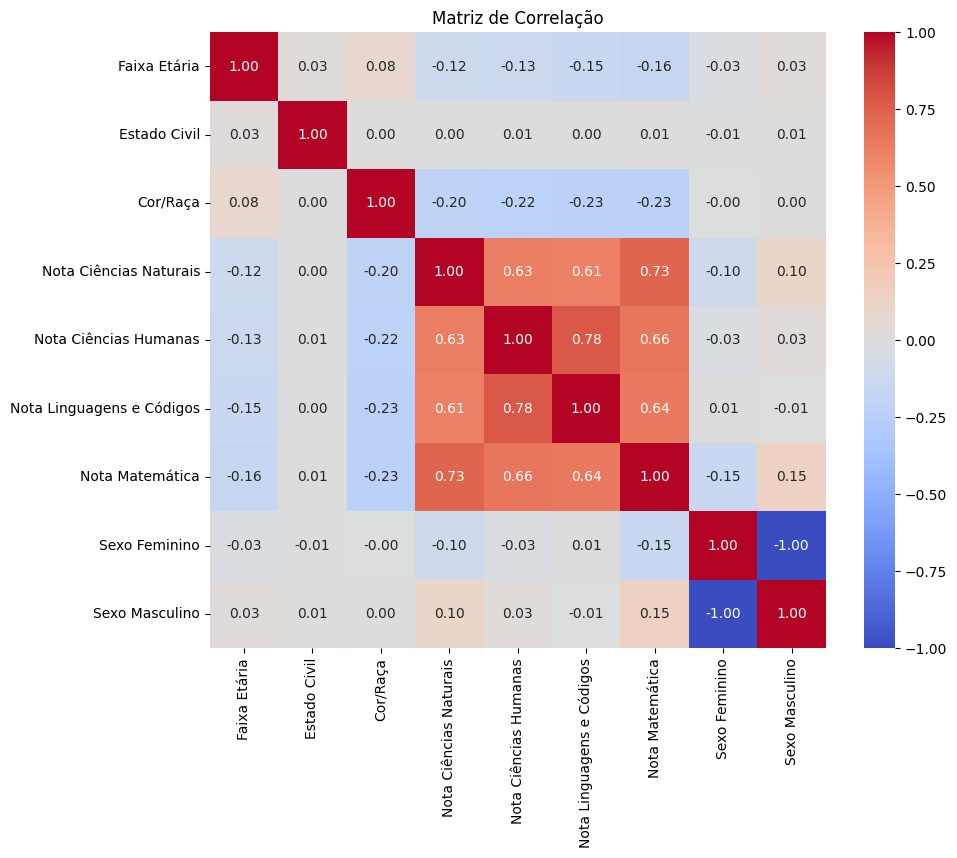

In [ ]:
# Plotar a matriz de correlação
plt.figure(figsize=(10, 8))
sns.heatmap(matriz_correlacao, annot=True, cmap='coolwarm', fmt=".2f", square=True)

plt.title('Matriz de Correlação')

plt.show()

In [ ]:
category_map = {
    0: 'Não declarado',
    1: 'Branca',
    2: 'Preta',
    3: 'Parda',
    4: 'Amarela',
    5: 'Indígena',
    6: 'Não dispõe da informação'
}

# Aplicando o mapeamento
df_analise['TP_COR_RACA'] = df_analise['TP_COR_RACA'].map(category_map)

# Contando as ocorrências de cada categoria
category_counts = df_analise['TP_COR_RACA'].value_counts().reset_index()
category_counts.columns = ['Categoria', 'Contagem']

# Criando o gráfico
fig = px.bar(category_counts, x='Categoria', y='Contagem', title='Contagem de TP_COR_RACA', labels={'Categoria': 'Cor/Raça', 'Contagem': 'Contagem'})

fig.show()

<ipython-input-12-ebe89f617ee1>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_analise['TP_COR_RACA'] = df_analise['TP_COR_RACA'].map(category_map)


In [ ]:
sexo_map = {
    'M': 'Masculino',
    'F': 'Feminino'
}

# Aplicando o mapeamento
df_analise['TP_SEXO'] = df_analise['TP_SEXO'].map(sexo_map)

# Adicionando uma nova coluna com M = 0 e F = 1
df_analise['SEXO_BINARIO'] = df_analise['TP_SEXO'].apply(lambda x: 0 if x == 'Masculino' else 1)

# Contando as ocorrências de cada categoria
sexo_counts = df_analise['TP_SEXO'].value_counts().reset_index()
sexo_counts.columns = ['Categoria', 'Contagem']

# Criando o gráfico
fig_sexo = px.bar(sexo_counts, x='Categoria', y='Contagem', title='Contagem de TP_SEXO', labels={'Categoria': 'Sexo', 'Contagem': 'Contagem'})

fig_sexo.show()

<ipython-input-13-5d7b40417bfd>:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-13-5d7b40417bfd>:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:

# Criando um DataFrame de contagem de cores por gênero
cor_por_genero = df_analise.groupby(['TP_COR_RACA', 'TP_SEXO']).size().reset_index(name='Contagem')

# Ordenando o DataFrame pela contagem de forma crescente
cor_por_genero = cor_por_genero.sort_values(by='Contagem', ascending=True)

# Criando o gráfico
fig_cor_genero = px.bar(
    cor_por_genero,
    x='TP_COR_RACA',
    y='Contagem',
    color='TP_SEXO',
    title='Contagem de TP_COR_RACA por Gênero',
    labels={'TP_COR_RACA': 'Cor/Raça', 'Contagem': 'Contagem', 'TP_SEXO': 'Gênero'},
    barmode='group'
)

fig_cor_genero.show()


In [ ]:
# Selecionando as colunas necessárias
df_notas = df_enem[['NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO', 'TP_ESCOLA', 'TP_LOCALIZACAO_ESC']]

# Mapeando os valores das colunas TP_ESCOLA e TP_LOCALIZACAO_ESC
escola_map = {
    1: 'Não Respondeu',
    2: 'Pública',
    3: 'Privada'
}

localizacao_map = {
    1: 'Urbana',
    2: 'Rural'
}

df_notas['TP_ESCOLA'] = df_notas['TP_ESCOLA'].map(escola_map)
df_notas['TP_LOCALIZACAO_ESC'] = df_notas['TP_LOCALIZACAO_ESC'].map(localizacao_map)

# Removendo as entradas onde TP_ESCOLA é "Não Respondeu"
df_notas = df_notas[df_notas['TP_ESCOLA'] != 'Não Respondeu']

# Calculando a média das notas por tipo de escola e localidade
media_notas = df_notas.groupby(['TP_ESCOLA', 'TP_LOCALIZACAO_ESC']).mean().reset_index()

# Convertendo o DataFrame para o formato longo para facilitar o plot
media_notas_long = media_notas.melt(id_vars=['TP_ESCOLA', 'TP_LOCALIZACAO_ESC'],
                                    value_vars=['NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO'],
                                    var_name='Disciplina',
                                    value_name='Média')

# Criando o gráfico
fig_notas = px.bar(media_notas_long,
                   x='Disciplina',
                   y='Média',
                   color='TP_ESCOLA',
                   facet_col='TP_LOCALIZACAO_ESC',
                   title='Média de Notas por Tipo de Escola e Localidade',
                   labels={'TP_ESCOLA': 'Tipo de Escola', 'TP_LOCALIZACAO_ESC': 'Localidade', 'Média': 'Média das Notas'})

fig_notas.show()

<ipython-input-15-f00330e59024>:16: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-15-f00330e59024>:17: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
# Selecionando as colunas necessárias
df_notas_renda = df_enem[['NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO', 'Q006']]

# Mapeando os valores da coluna Q006 com rótulos mais descritivos
renda_map = {
    'A': 'Nenhuma Renda',
    'B': 'Até 1.320 reais',
    'C': '1.320 a 1.980 reais',
    'D': '1.980 a 2.640 reais',
    'E': '2.640 a 3.300 reais',
    'F': '3.300 a 3.960 reais',
    'G': '3.960 a 5.280 reais',
    'H': '5.280 a 6.600 reais',
    'I': '6.600 a 7.920 reais',
    'J': '7.920 a 9.240 reais',
    'K': '9.240 a 10.560 reais',
    'L': '10.560 a 11.880 reais',
    'M': '11.880 a 13.200 reais',
    'N': '13.200 a 15.840 reais',
    'O': '15.840 a 19.800 reais',
    'P': '19.800 a 26.400 reais',
    'Q': 'Acima de 26.400 reais'
}

df_notas_renda['Q006'] = df_notas_renda['Q006'].map(renda_map)

# Removendo as entradas onde a renda não está definida
df_notas_renda = df_notas_renda[df_notas_renda['Q006'].notna()]

# Calculando a nota geral (média das notas das disciplinas para cada aluno)
df_notas_renda['NOTA_GERAL'] = df_notas_renda[['NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO']].mean(axis=1)

# Calculando a média das notas gerais por faixa de renda
media_notas_geral_renda = df_notas_renda.groupby('Q006')['NOTA_GERAL'].mean().reset_index()

# Ordenando o DataFrame pela faixa de renda
renda_ordenada = [
    'Nenhuma Renda', 'Até 1.320 reais', '1.320 a 1.980 reais',
    '1.980 a 2.640 reais', '2.640 a 3.300 reais',
    '3.300 a 3.960 reais', '3.960 a 5.280 reais',
    '5.280 a 6.600 reais', '6.600 a 7.920 reais',
    '7.920 a 9.240 reais', '9.240 a 10.560 reais',
    '10.560 a 11.880 reais', '11.880 a 13.200 reais',
    '13.200 a 15.840 reais', '15.840 a 19.800 reais',
    '19.800 a 26.400 reais', 'Acima de 26.400 reais'
]
media_notas_geral_renda['Q006'] = pd.Categorical(media_notas_geral_renda['Q006'], categories=renda_ordenada, ordered=True)
media_notas_geral_renda = media_notas_geral_renda.sort_values('Q006')

# Criando o gráfico de mapa de calor em pé
fig_nota_geral_renda = px.imshow(media_notas_geral_renda[['Q006', 'NOTA_GERAL']].set_index('Q006'),
                                 aspect="auto",
                                 title='Média da Nota Geral por Faixa de Renda',
                                 labels={'x': 'Faixa de Renda', 'y': 'Nota Geral'},
                                 color_continuous_scale=px.colors.sequential.Viridis[::-1])  # Invertendo a escala de cores

# Ajustando a orientação dos rótulos
fig_nota_geral_renda.update_layout(
    yaxis=dict(tickmode='linear', dtick=1, tickangle=0)
)

fig_nota_geral_renda.show()

<ipython-input-16-9b83b77c3bef>:25: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:

# Primeiro, selecione as colunas de interesse
uf_codes = df[['CO_UF_PROVA', 'SG_UF_PROVA']]

# Agrupe pelo nome da UF e obtenha os códigos únicos de cada UF
uf_grouped = uf_codes.groupby('SG_UF_PROVA')['CO_UF_PROVA'].unique().reset_index()

# Exiba o resultado
print(uf_grouped)


   SG_UF_PROVA CO_UF_PROVA
0           AC        [12]
1           AL        [27]
2           AM        [13]
3           AP        [16]
4           BA        [29]
5           CE        [23]
6           DF        [53]
7           ES        [32]
8           GO        [52]
9           MA        [21]
10          MG        [31]
11          MS        [50]
12          MT        [51]
13          PA        [15]
14          PB        [25]
15          PE        [26]
16          PI        [22]
17          PR        [41]
18          RJ        [33]
19          RN        [24]
20          RO        [11]
21          RR        [14]
22          RS        [43]
23          SC        [42]
24          SE        [28]
25          SP        [35]
26          TO        [17]


In [ ]:
# Definindo as regiões
regions = {
    'Norte': ['AC', 'AP', 'AM', 'PA', 'RO', 'RR', 'TO'],
    'Nordeste': ['AL', 'BA', 'CE', 'MA', 'PB', 'PE', 'PI', 'RN', 'SE'],
    'Sudeste': ['ES', 'MG', 'RJ', 'SP'],
    'Sul': ['PR', 'RS', 'SC'],
    'Centro-Oeste': ['DF', 'GO', 'MT', 'MS']
}

# Criando um dicionário para mapear as UFs às regiões
uf_to_region = {uf: region for region, ufs in regions.items() for uf in ufs}


In [ ]:
# Definindo as regiões
regions = {
    'Norte': ['AC', 'AP', 'AM', 'PA', 'RO', 'RR', 'TO'],
    'Nordeste': ['AL', 'BA', 'CE', 'MA', 'PB', 'PE', 'PI', 'RN', 'SE'],
    'Sudeste': ['ES', 'MG', 'RJ', 'SP'],
    'Sul': ['PR', 'RS', 'SC'],
    'Centro-Oeste': ['DF', 'GO', 'MT', 'MS']
}

# Criando um dicionário para mapear as UFs às regiões
uf_to_region = {uf: region for region, ufs in regions.items() for uf in ufs}

# Selecionando as colunas relevantes para a análise
df_sg_regiao = df[['SG_UF_ESC', 'TP_PRESENCA_CN', 'TP_PRESENCA_CH', 'TP_PRESENCA_LC', 'TP_PRESENCA_MT']]

# Adicionando a coluna de região
df_sg_regiao['REGION'] = df_sg_regiao['SG_UF_ESC'].map(uf_to_region)

# Selecionando apenas as presenças (valores iguais a 1)
df_sg_regiao['PRESENCA_CN'] = df_sg_regiao['TP_PRESENCA_CN'] == 1
df_sg_regiao['PRESENCA_CH'] = df_sg_regiao['TP_PRESENCA_CH'] == 1
df_sg_regiao['PRESENCA_LC'] = df_sg_regiao['TP_PRESENCA_LC'] == 1
df_sg_regiao['PRESENCA_MT'] = df_sg_regiao['TP_PRESENCA_MT'] == 1

# Agrupando por região e contando as presenças
df_count = df_sg_regiao.groupby('REGION')[['PRESENCA_CN', 'PRESENCA_CH', 'PRESENCA_LC', 'PRESENCA_MT']].sum().reset_index()

# Exibindo o dataframe resultante
print("DataFrame Agrupado por Região com Contagem de Presenças")
print(df_count)


<ipython-input-19-4d12167664c6>:17: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-19-4d12167664c6>:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-19-4d12167664c6>:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-19-4d12

DataFrame Agrupado por Região com Contagem de Presenças
         REGION  PRESENCA_CN  PRESENCA_CH  PRESENCA_LC  PRESENCA_MT
0  Centro-Oeste        66888        69982        69982        66888
1      Nordeste       237951       245216       245216       237951
2         Norte        63245        66069        66069        63245
3       Sudeste       260389       270643       270643       260389
4           Sul        95912       100736       100736        95912


In [ ]:
import plotly.express as px

# Criar o DataFrame no formato longo para plotagem com Plotly
df_long_count = df_count.melt(id_vars='REGION', value_vars=['PRESENCA_CN', 'PRESENCA_CH', 'PRESENCA_LC', 'PRESENCA_MT'],
                              var_name='Disciplina', value_name='Contagem de Presença')

# Mapeando os nomes das disciplinas para algo mais legível
discipline_map = {
    'PRESENCA_CN': 'Ciências da Natureza',
    'PRESENCA_CH': 'Ciências Humanas',
    'PRESENCA_LC': 'Linguagens e Códigos',
    'PRESENCA_MT': 'Matemática'
}

df_long_count['Disciplina'] = df_long_count['Disciplina'].map(discipline_map)

# Criando o gráfico de barras
fig = px.bar(df_long_count, x='REGION', y='Contagem de Presença', color='Disciplina',
             barmode='group', title='Contagem de Presença nas Provas por Região')

# Ajustar os rótulos dos eixos
fig.update_layout(
    xaxis_title='Região',
    yaxis_title='Contagem de Presença',
    legend_title_text='Disciplina'
)

# Exibir o gráfico
fig.show()


In [ ]:
# Supomos que df_enem já está carregado com os dados necessários
df_renda_regiao = df_enem[['SG_UF_ESC', 'Q006']]

# Mapeando os valores da coluna Q006 com rótulos mais descritivos
renda_map = {
    'A': 'Nenhuma Renda',
    'B': 'Até 1.320 reais',
    'C': '1.320 a 1.980 reais',
    'D': '1.980 a 2.640 reais',
    'E': '2.640 a 3.300 reais',
    'F': '3.300 a 3.960 reais',
    'G': '3.960 a 5.280 reais',
    'H': '5.280 a 6.600 reais',
    'I': '6.600 a 7.920 reais',
    'J': '7.920 a 9.240 reais',
    'K': '9.240 a 10.560 reais',
    'L': '10.560 a 11.880 reais',
    'M': '11.880 a 13.200 reais',
    'N': '13.200 a 15.840 reais',
    'O': '15.840 a 19.800 reais',
    'P': '19.800 a 26.400 reais',
    'Q': 'Acima de 26.400 reais'
}

df_renda_regiao['Q006'] = df_renda_regiao['Q006'].map(renda_map)

# Criando um dicionário para mapear as UFs às regiões
regions = {
    'Norte': ['AC', 'AP', 'AM', 'PA', 'RO', 'RR', 'TO'],
    'Nordeste': ['AL', 'BA', 'CE', 'MA', 'PB', 'PE', 'PI', 'RN', 'SE'],
    'Sudeste': ['ES', 'MG', 'RJ', 'SP'],
    'Sul': ['PR', 'RS', 'SC'],
    'Centro-Oeste': ['DF', 'GO', 'MT', 'MS']
}

uf_to_region = {uf: region for region, ufs in regions.items() for uf in ufs}

# Adicionando a coluna de região
df_renda_regiao['REGION'] = df_renda_regiao['SG_UF_ESC'].map(uf_to_region)

# Removendo as entradas onde a renda ou região não estão definidas
df_renda_regiao = df_renda_regiao.dropna(subset=['Q006', 'REGION'])

# Definindo a ordem das faixas de renda
renda_order = [
    'Nenhuma Renda', 'Até 1.320 reais', '1.320 a 1.980 reais', '1.980 a 2.640 reais',
    '2.640 a 3.300 reais', '3.300 a 3.960 reais', '3.960 a 5.280 reais', '5.280 a 6.600 reais',
    '6.600 a 7.920 reais', '7.920 a 9.240 reais', '9.240 a 10.560 reais', '10.560 a 11.880 reais',
    '11.880 a 13.200 reais', '13.200 a 15.840 reais', '15.840 a 19.800 reais', '19.800 a 26.400 reais',
    'Acima de 26.400 reais'
]

# Criando o gráfico de violino
fig = px.violin(df_renda_regiao, x='REGION', y='Q006', color='REGION',
                title='Distribuição de Faixa de Renda por Região',
                labels={'REGION': 'Região', 'Q006': 'Faixa de Renda'},
                category_orders={'Q006': renda_order})

# Ajustar os rótulos dos eixos
fig.update_layout(
    xaxis_title='Região',
    yaxis_title='Faixa de Renda',
    legend_title_text='Região'
)

# Exibir o gráfico
fig.show()


<ipython-input-26-187b66e3cc43>:25: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-26-187b66e3cc43>:39: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

